<a href="https://colab.research.google.com/github/Jathurshan0330/Cine-Cardiac-MRI-Motion-Artefact-Reduction/blob/master/Evaluation_Recurrent_Generative_Adversarial_Network.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Get Requirements

In [ ]:
!git clone https://github.com/Jathurshan0330/Cine-Cardiac-MRI-Motion-Artefact-Reduction.git

Cloning into 'Cine-Cardiac-MRI-Motion-Artefact-Reduction'...
remote: Enumerating objects: 102, done.
remote: Counting objects: 100% (102/102), done.
remote: Compressing objects: 100% (78/78), done.
remote: Total 102 (delta 52), reused 39 (delta 14), pack-reused 0
Receiving objects: 100% (102/102), 62.09 MiB | 8.76 MiB/s, done.
Resolving deltas: 100% (52/52), done.


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
from IPython.display import clear_output

In [ ]:
!pip install neptune-client
!pip install medpy
clear_output()

In [ ]:
%cd /content/Cine-Cardiac-MRI-Motion-Artefact-Reduction
import neptune.new as neptune
import torch
import os
from glob import glob
import time
import re
import argparse
import nibabel as nib
import pandas as pd
from medpy.metric.binary import hd, dc
import numpy as np
from ipywidgets import interact, interactive, IntSlider, ToggleButtons
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
import torch
import torch.nn as nn
sns.set_style('darkgrid')
from seaborn.matrix import clustermap
import h5py
from matplotlib.patches import Rectangle
from torch.utils.data import Dataset
from torch.utils import data
from torchvision import transforms, datasets
from torchvision.transforms.transforms import ToTensor
from torchvision import models
from torch import autograd
from matplotlib.animation import FuncAnimation
from IPython import display
from torchvision.utils import make_grid
from skimage.metrics import structural_similarity as ssim
from skimage.metrics import peak_signal_noise_ratio as psnr
import time
import random

from utils.metrics_acdc import load_nii
from utils.vis_cine import interactive_gif_data, AnimationFunction
from utils.avg_metrics import AverageMeter, img_net_normalize, weights_init
from datasets.cine_dataset import read_h5py, calculate_2dft, calculate_2dift,  CineCardiac #add_motion_artefacts
from model.networks import  ConvLSTM_block, Generator, Discriminator, Vgg16, gradient_penalty 
from model.networks import conv_block, convtranspose_block, multi_scale_conv, ConvLSTMCell, ConvLSTM, ConvLSTM_block, encoder, decoder

/content/Cine-Cardiac-MRI-Motion-Artefact-Reduction


# Load Test Dataset 

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
device

device(type='cuda')

In [ ]:
#Cine Cardiac MRI Dataset
val_data = glob("/content/drive/MyDrive/Cine Cardiac/val_data/val_*_slice_*.h5")
print(val_data)

cine_val = CineCardiac(data_list = val_data, 
                          device = device, data_type = 'Val', 
                          transform=transforms.Compose([
                          transforms.ToTensor(),
                          ])) 

#Val Data Loader
val_data_loader = data.DataLoader(cine_val, batch_size = 1, shuffle = False)
clear_output()

torch.Size([1, 7, 100, 100]) torch.Size([1, 7, 100, 100]) torch.Size([1, 7, 100, 100])
tensor(0., device='cuda:0', dtype=torch.float64) tensor(0., device='cuda:0', dtype=torch.float64) tensor(0., device='cuda:0')
tensor(1., device='cuda:0', dtype=torch.float64) tensor(1., device='cuda:0', dtype=torch.float64) tensor(1., device='cuda:0')


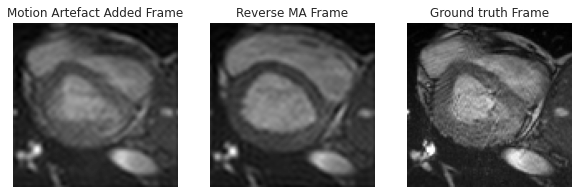

interactive(children=(IntSlider(value=0, description='Select slice', max=0), Output()), _dom_classes=('widget-…

In [ ]:
img,img_inv, label   = next(iter(val_data_loader))
print(img.shape,img_inv.shape, label.shape)
print(img.min(),img_inv.min(), label.min())
print(img.max(),img_inv.max(), label.max())
ind = 0
fig, ax = plt.subplots(1,3, figsize=(10,10))
ax[0].imshow(img[ind,0,:,:].cpu(), cmap='gray'), ax[0].set_title('Motion Artefact Added Frame'),ax[0].axis("off")
ax[1].imshow(img_inv[ind,0,:,:].cpu(), cmap='gray'), ax[1].set_title('Reverse MA Frame'),ax[1].axis("off")
ax[2].imshow(label[ind,0,:,:].cpu(), cmap='gray'), ax[2].set_title('Ground truth Frame'),ax[2].axis("off")
plt.show()

interactive_gif_data(img.cpu(), cmap = 'gray')


In [ ]:
interactive_gif_data(label.cpu(), cmap = 'gray')

interactive(children=(IntSlider(value=0, description='Select slice', max=0), Output()), _dom_classes=('widget-…

# Load Models

In [ ]:
#Load Model
#Link to the models
#convlstm_forward = https://drive.google.com/file/d/15bqyWeV8EkGx39y3Zjv6ndCx_WkCoR6V/view?usp=sharing
#convlstm_backward = https://drive.google.com/file/d/16NFuObuTiw0TuBq5ebghViAhLX-7GP_e/view?usp=sharing
#gen = https://drive.google.com/file/d/1iDv5Q8MXaK3DRU7gpfLJQNs4bD5mszlw/view?usp=sharing



convlstm_forward = torch.load('/content/drive/MyDrive/Cine Cardiac/Models/12convlstm_forward_best_psnr.pth.tar')
convlstm_forward.eval()
convlstm_backward = torch.load('/content/drive/MyDrive/Cine Cardiac/Models/12convlstm_backward_best_psnr.pth.tar')
convlstm_backward.eval()
gen = torch.load("/content/drive/MyDrive/Cine Cardiac/Models/12gen_best_psnr.pth.tar")
gen.eval()
vgg =  Vgg16().to(device)
vgg.eval()

mse_loss = nn.MSELoss()
#Testing the model
img,img_inv, label   = next(iter(val_data_loader))
print(img.shape,img_inv.shape, label.shape)
print(img.shape,img_inv.shape, label.shape)

sides = []
f1,f2,f3 = convlstm_forward(img.float()) 
b1,b2,b3 = convlstm_backward(img_inv.float())
print(f1.shape,f2.shape,f3.shape)
print(b1.shape,b2.shape,b3.shape)

for i in range (7):
  out_img = gen(img[:,i,:,:].view(img.shape[0],1,100,100).float(),f1[:,i,:,:,:], f2[:,i,:,:,:], f3[:,i,:,:,:],
                b1[:,i,:,:,:], b2[:,i,:,:,:], b3[:,i,:,:,:])
  sides.append(out_img)
  print(out_img.shape)


print(len(sides),sides[0].shape)

torch.Size([1, 7, 100, 100]) torch.Size([1, 7, 100, 100]) torch.Size([1, 7, 100, 100])
torch.Size([1, 7, 100, 100]) torch.Size([1, 7, 100, 100]) torch.Size([1, 7, 100, 100])
torch.Size([1, 7, 32, 100, 100]) torch.Size([1, 7, 64, 100, 100]) torch.Size([1, 7, 128, 100, 100])
torch.Size([1, 7, 32, 100, 100]) torch.Size([1, 7, 64, 100, 100]) torch.Size([1, 7, 128, 100, 100])
torch.Size([1, 1, 100, 100])
torch.Size([1, 1, 100, 100])
torch.Size([1, 1, 100, 100])
torch.Size([1, 1, 100, 100])
torch.Size([1, 1, 100, 100])
torch.Size([1, 1, 100, 100])
torch.Size([1, 1, 100, 100])
7 torch.Size([1, 1, 100, 100])


# Evaluation 

In [ ]:
track_experiment = False  # Change to true if you want to track experiments using neptune

if track_experiment:
  

  run = neptune.init(
      project="Project Name",
      api_token="Api token",
  )  # your credentials


  run['model/ConvLSTM'] = convlstm_forward
  run['model/Generator'] = gen

https://app.neptune.ai/jathurshan0330/Cine-Cardiac/e/CIN-16
Remember to stop your run once you’ve finished logging your metadata (https://docs.neptune.ai/api-reference/run#.stop). It will be stopped automatically only when the notebook kernel/interactive console is terminated.


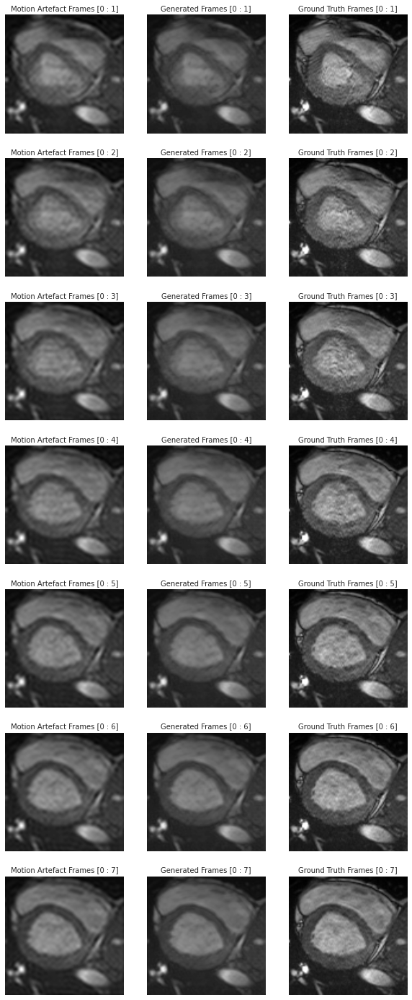

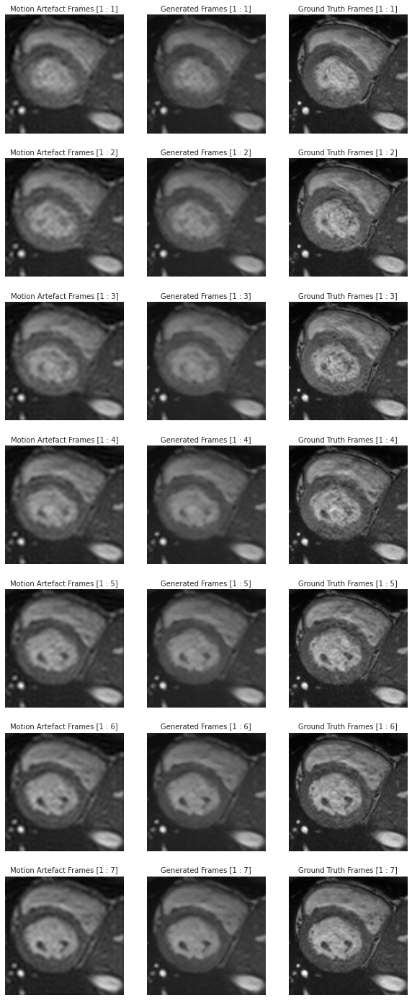

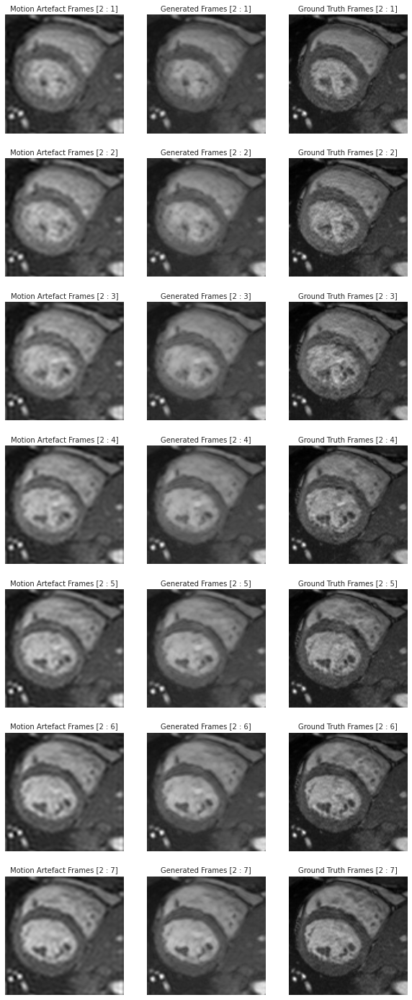

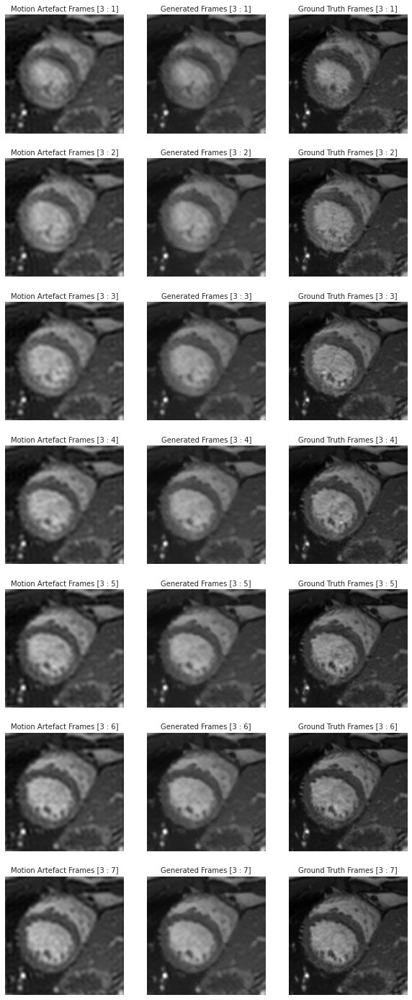

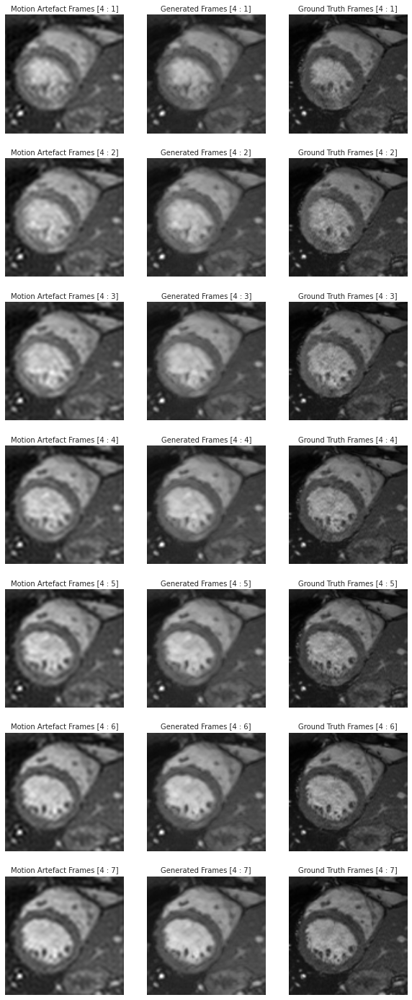

...

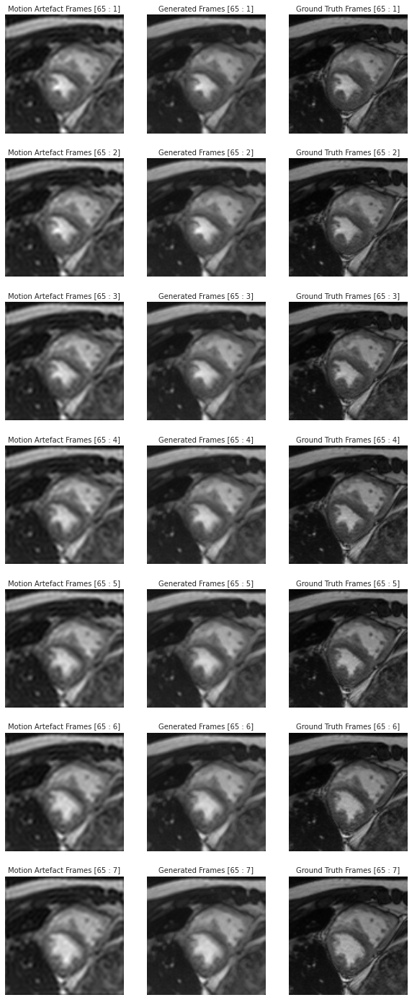

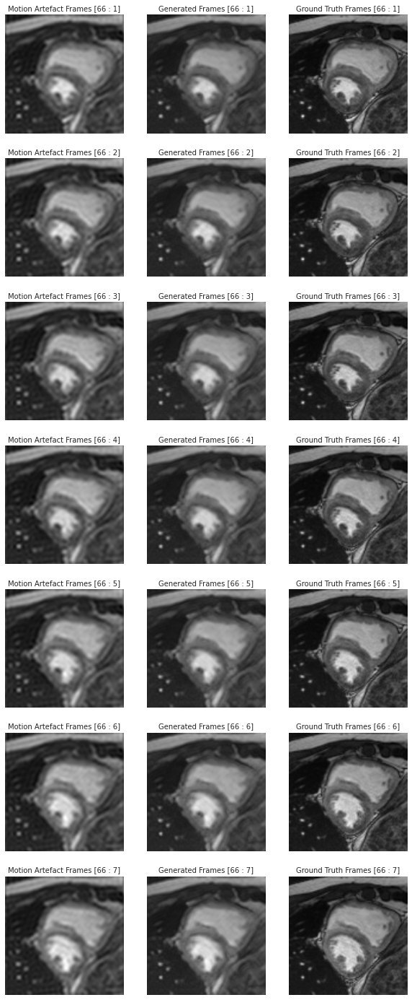

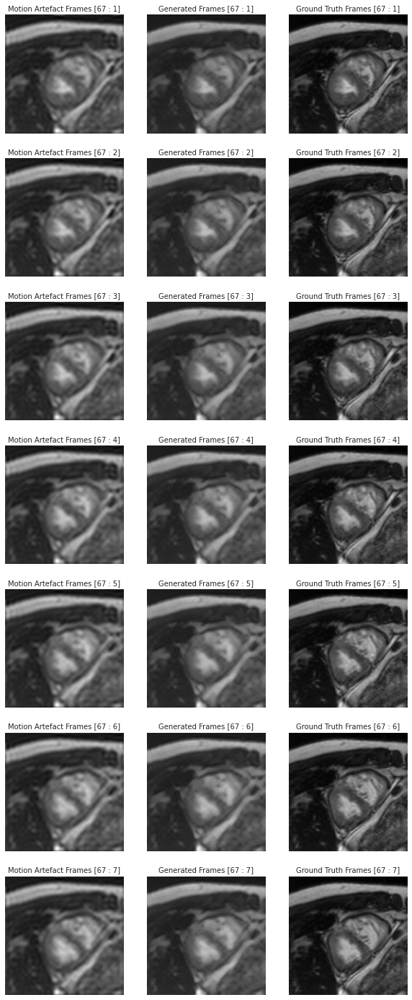

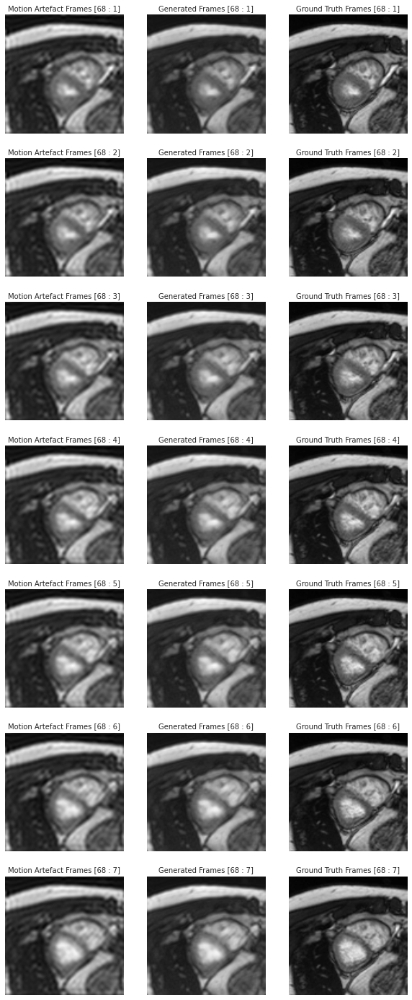

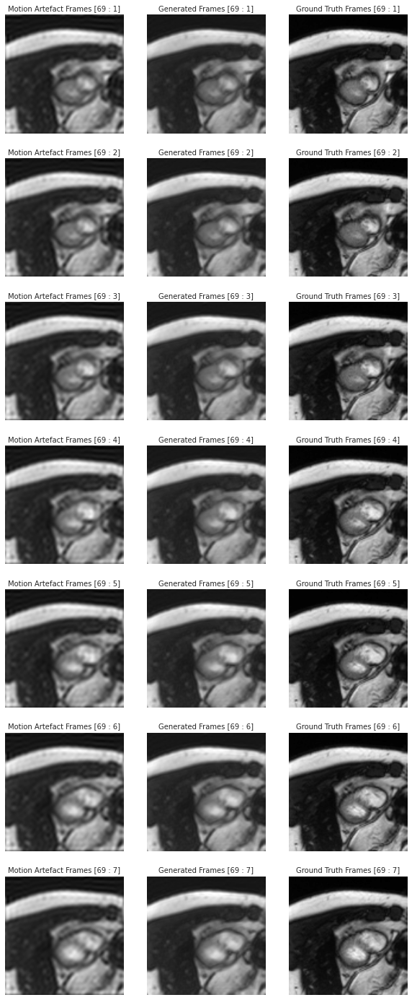

=========================================================== Evaluation ===========================================================================================================>
Validation ===================>
Input Perceptual Loss : 0.4074726402759552
Validation Perceptual Loss : 0.3171805739402771
Input MA Frames PSNR       : 21.577622088271305
Input MA Frames SSIM       : 0.7386134435662854
Validation PSNR            : 21.885970164062925
Validation SSIM            : 0.7448663584979359
===================================== Finished Evalutation ==================================================


In [ ]:
#Training Script

num_frames = 7
in_percep_losses = AverageMeter()
val_percep_losses = AverageMeter()
PSNR_in = AverageMeter()
SSIM_in = AverageMeter()
PSNR_val = AverageMeter()
SSIM_val = AverageMeter()
######################## Validation #######################################################
with torch.no_grad():
  for batch_val_idx, data_val_input in enumerate(val_data_loader):
    val_img = data_val_input[0].to(device) 
    inv_val_img = data_val_input[1].to(device) 
    gt_val_img = data_val_input[2].to(device)

    #ConvLSTMs (Forward and Backward)
    f1_val,f2_val,f3_val = convlstm_forward(val_img.float()) 
    b1_val,b2_val,b3_val = convlstm_backward(inv_val_img.float())

    gen_frames = torch.Tensor([]).to(device)
    for k in range (num_frames):
      gen_val_img = gen(val_img[:,k,:,:].view(val_img.shape[0],1,100,100).float(),f1_val[:,k,:,:,:], f2_val[:,k,:,:,:], f3_val[:,k,:,:,:],
                        b1_val[:,k,:,:,:], b2_val[:,k,:,:,:], b3_val[:,k,:,:,:])
      
      # For visualization
      gen_frames = torch.cat((gen_frames,gen_val_img))
      
      #Perceptual loss
      in_features = vgg(img_net_normalize(val_img[:,k,:,:].view(gt_val_img.shape[0],1,100,100).float()))
      gen_features = vgg(img_net_normalize(gen_val_img))
      gt_features = vgg(img_net_normalize(gt_val_img[:,k,:,:].view(gt_val_img.shape[0],1,100,100).float()))
      
      in_percep_loss  = 0 
      val_percep_loss = 0
      for f_map in range(4):  
        val_percep_loss += 0.25 * mse_loss(gen_features[f_map], gt_features[f_map]) / num_frames
        in_percep_loss += 0.25 * mse_loss(in_features[f_map], gt_features[f_map]) / num_frames

      SSIM = ssim(gt_val_img[:,k,:,:].squeeze().detach().cpu().numpy().astype("float"), gen_val_img.squeeze().detach().cpu().numpy().astype("float"), 
                  data_range = gen_val_img.squeeze().detach().cpu().numpy().max() - gen_val_img.squeeze().detach().cpu().numpy().min())
      PSNR = psnr(gt_val_img[:,k,:,:].squeeze().detach().cpu().numpy().astype("float"), gen_val_img.squeeze().detach().cpu().numpy().astype("float"), 
                  data_range = gen_val_img.squeeze().detach().cpu().numpy().max() - gen_val_img.squeeze().detach().cpu().numpy().min())
      
      SSIM_input = ssim(gt_val_img[:,k,:,:].squeeze().detach().cpu().numpy().astype("float"), val_img[:,k,:,:].squeeze().detach().cpu().numpy().astype("float"), 
                  data_range = val_img[:,k,:,:].squeeze().detach().cpu().numpy().max() - val_img[:,k,:,:].squeeze().detach().cpu().numpy().min())
      PSNR_input = psnr(gt_val_img[:,k,:,:].squeeze().detach().cpu().numpy().astype("float"), val_img[:,k,:,:].squeeze().detach().cpu().numpy().astype("float"), 
                  data_range = val_img[:,k,:,:].squeeze().detach().cpu().numpy().max() - val_img[:,k,:,:].squeeze().detach().cpu().numpy().min())

      in_percep_losses.update(in_percep_loss)
      val_percep_losses.update(val_percep_loss)
      PSNR_val.update(PSNR)
      SSIM_val.update(SSIM)
      PSNR_in.update(PSNR_input)
      SSIM_in.update(SSIM_input)
  
    #Visualization
    fig, ax = plt.subplots(num_frames,3, figsize=(10,25))
    for k in range (num_frames):
      ax[k][0].imshow(val_img[0,k,:,:].cpu(), cmap='gray',vmin = 0,vmax = 1,interpolation ='bilinear')
      ax[k][0].set_title(f"Motion Artefact Frames [{batch_val_idx} : {k+1}]",fontsize = 10),ax[k][0].axis('off')

      ax[k][1].imshow(gen_frames[k,0,:,:].cpu(), cmap='gray',vmin = 0,vmax = 1,interpolation ='bilinear')
      ax[k][1].set_title(f"Generated Frames [{batch_val_idx} : {k+1}]",fontsize = 10),ax[k][1].axis('off')
      
      ax[k][2].imshow(gt_val_img[0,k,:,:].cpu(), cmap='gray',vmin = 0,vmax = 1,interpolation ='bilinear')
      ax[k][2].set_title(f"Ground Truth Frames [{batch_val_idx} : {k+1}]",fontsize = 10),ax[k][2].axis('off')
    plt.show()
      
    if track_experiment:
      run['train/epoch/Comparision img'].log(fig)


    # input_ma_img_grid = make_grid(val_img.view(7,1,100,100).detach().cpu(), nrow = 7)
    
    # fig = plt.figure(figsize = (30,40))
    # plt.imshow(input_ma_img_grid.permute(1, 2, 0).squeeze(),vmax = 1, vmin = 0)
    # plt.title(f"Motion Artefact Frames {batch_val_idx}")
    # plt.axis('off')
    # plt.show()
    # if track_experiment:
    #   run['train/epoch/Motion Artefact Frames'].log(fig)

    # # gen_frames =torch.Tensor(gen_frames)#.cpu())#.detach().cpu())
    # generated_grid = make_grid(gen_frames.view(7,1,100,100).detach().cpu(), nrow = 7)

    # fig = plt.figure(figsize = (30,40))
    # plt.imshow(generated_grid.permute(1, 2, 0).squeeze(),vmax = 1, vmin = 0)
    # plt.title(f"Generated Frames {batch_val_idx}")
    # plt.axis('off')
    # plt.show()
    # if track_experiment:
    #   run['train/epoch/Generated Frames'].log(fig)

    # gt_img_grid = make_grid(gt_val_img.view(7,1,100,100).detach().cpu(), nrow = 7)
    
    # fig = plt.figure(figsize = (30,40))
    # plt.imshow(gt_img_grid.permute(1, 2, 0).squeeze(),vmax = 1, vmin = 0)
    # plt.title(f"Ground Truth Frames {batch_val_idx}")
    # plt.axis('off')
    # plt.show()
    # if track_experiment:  
    #   run['train/epoch/Ground Truth Frames'].log(fig)
    # break
  print(f'=========================================================== Evaluation ===========================================================================================================>')
  print("Validation ===================>")
  print(f"Input Perceptual Loss : {in_percep_losses.avg}")
  print(f"Validation Perceptual Loss : {val_percep_losses.avg}")
  print(f"Input MA Frames PSNR       : {PSNR_in.avg}")
  print(f"Input MA Frames SSIM       : {SSIM_in.avg}")
  print(f"Validation PSNR            : {PSNR_val.avg}")
  print(f"Validation SSIM            : {SSIM_val.avg}")
  

  
  if track_experiment:
    run['train/epoch/Validation Perceptual Loss'].log(val_percep_losses.avg)
    run['train/epoch/Validation PSNR'].log(PSNR_val.avg)
    run['train/epoch/Validation SSIM'].log(SSIM_val.avg)



  print(f"===================================== Finished Evalutation ==================================================")
